In [1]:
import pandas as pd
import plotly.express as px
import seaborn as sn
import os
import matplotlib.pyplot as plt
from problema1.src.preprocessing import *
from problema1.src.data_splitting import *
from problema1.src.metrics import *
from problema1.src.models import *

In [2]:
file_path = 'problema1/data/raw/cell_diagnosis_dev.csv'
df = pd.read_csv(file_path)

# visualise null table
null_table = null_analysis(df)
px.bar(null_table.reset_index(), x='index', y='percentage', text='counts', height=500)


Debido a la alta cantidad de datos faltantes que habia en el dataset, decidi no remover los Nans, y reemplazarlos por la media de la feature

289 (21.73%) outliers removed
96 (28.83%) outliers removed


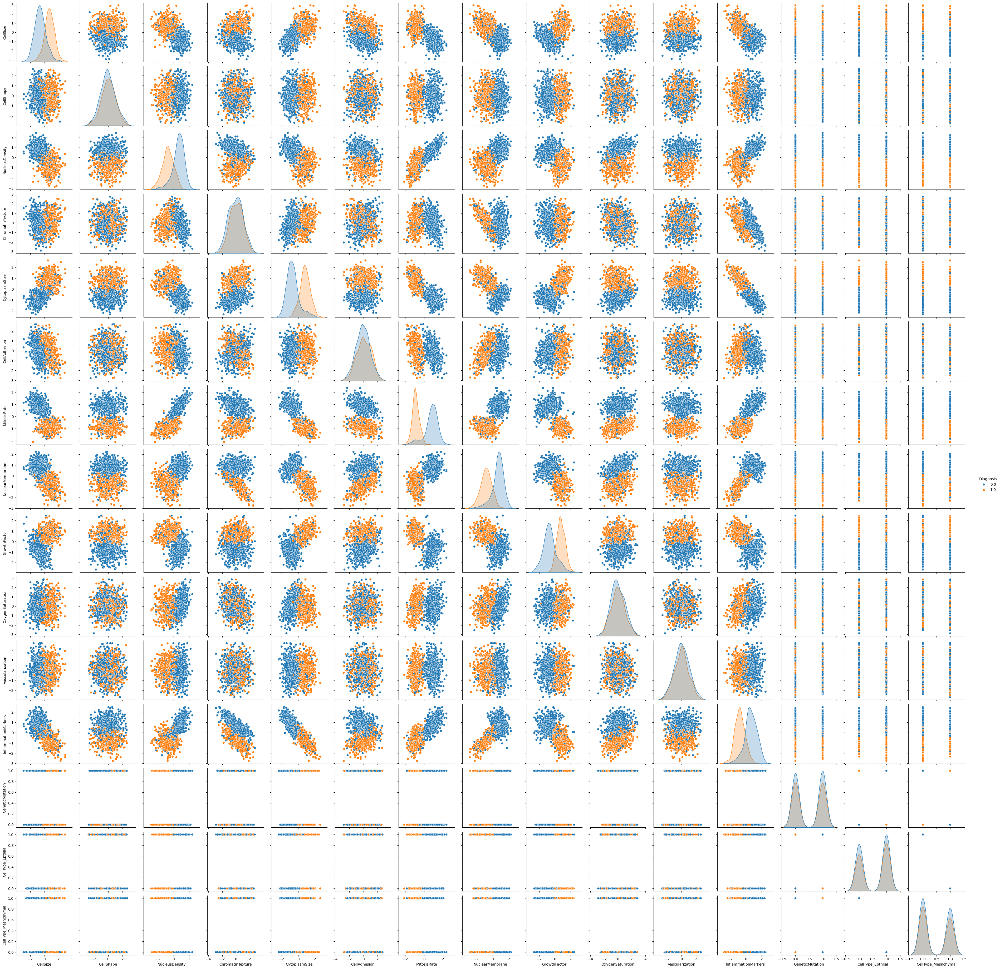

In [3]:
df_train, df_val = train_val_split(df)

df_train = replace_question_marks_with_nan(df_train,'CellType')
df_train = knn_impute_all_optimized(df_train) 
df_train = boxplot_outlier_removal(df_train,exclude=['Diagnosis','CellType','GeneticMutation'])
df_train = one_hot_encode_column(df_train,'CellType')
df_train = convert_to_binary(df_train,'GeneticMutation')
df_train, stats_train = normalize_columns(df_train, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_train.to_csv('problema1/data/processed/train_cleaned_cell_diagnosis_dev.csv', index=False)

df_val = replace_question_marks_with_nan(df_val,'CellType')
df_val = knn_impute_all_optimized(df_val) 
df_val = boxplot_outlier_removal(df_val,exclude=['Diagnosis','CellType','GeneticMutation'])
df_val = one_hot_encode_column(df_val,'CellType')
df_val = convert_to_binary(df_val,'GeneticMutation')
df_val, stats_val = normalize_columns(df_val, stats=stats_train, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_val.to_csv('problema1/data/processed/val_cleaned_cell_diagnosis_dev.csv', index=False)

sn.pairplot(df_train, hue='Diagnosis')

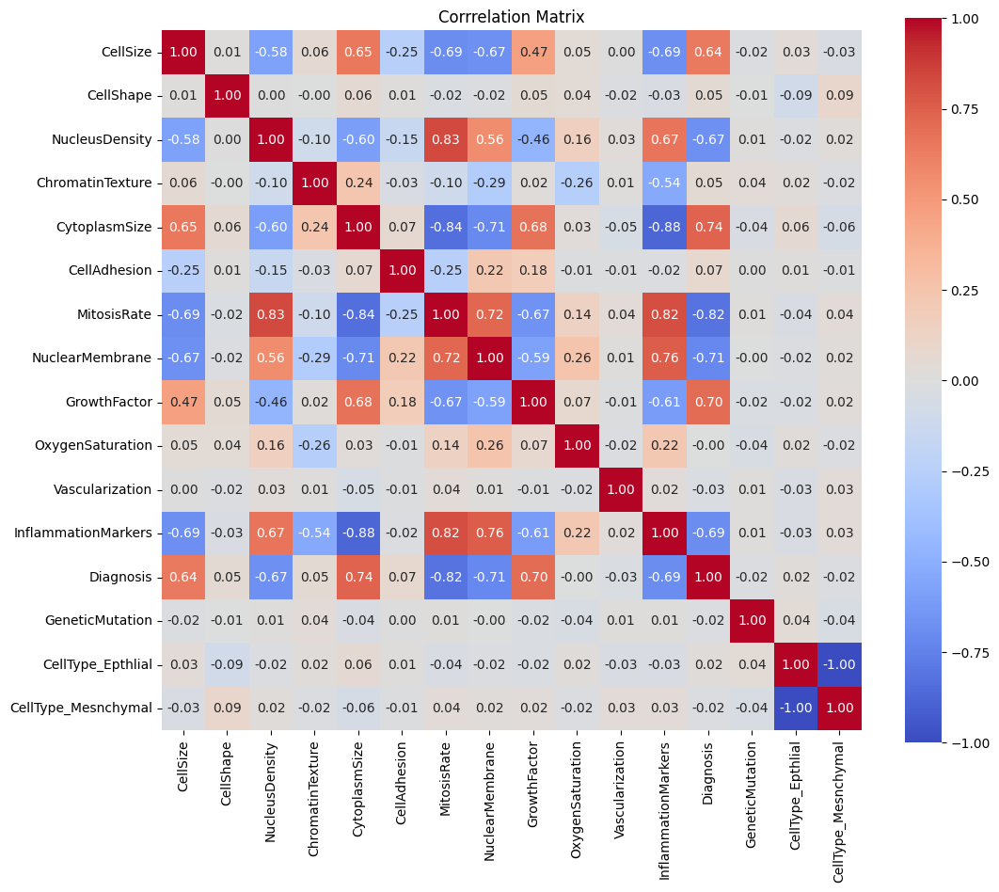

In [4]:
matrix = df_train.corr()

plt.figure(figsize=(12,10))
sn.heatmap(matrix,annot=True, fmt=".2f",cmap='coolwarm',square=True)
plt.title('Corrrelation Matrix')
plt.show()

Precision: 0.8706896551724138
Reacall: 0.9901960784313726
Accuracy: 0.9324894514767933
F-score: 0.9266055045871561


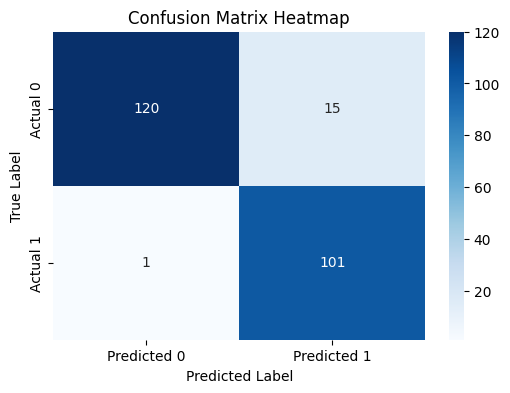

AUC-PR: 0.9096149796314655


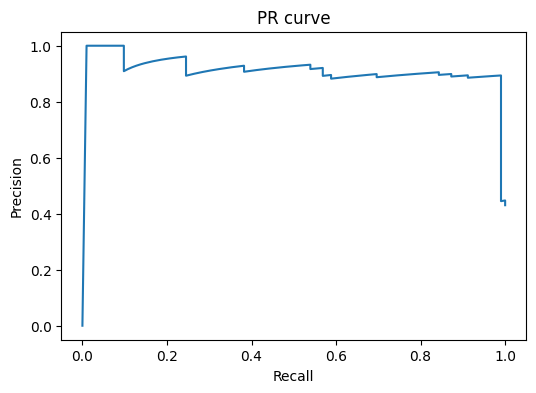

AUC-ROC: 0.9514161220043574


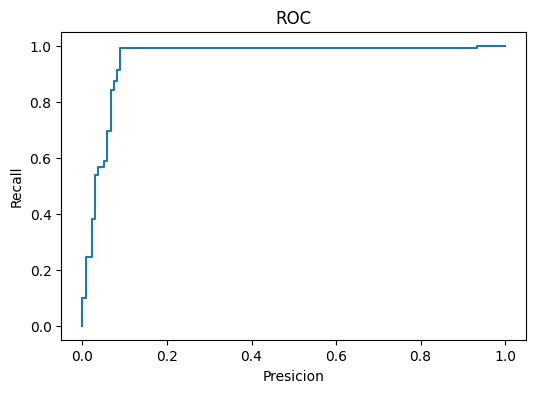

In [5]:
X_train = df_train.drop(columns=['Diagnosis'])
Y_train = df_train['Diagnosis']

X_val = df_val.drop(columns=['Diagnosis'])
Y_val = df_val['Diagnosis']

model = LogisticRegressionL2()
model.fit(X_train,Y_train)
Y_pred = model.predict(X_val)
Y_pred_prob = model.predict_proba(X_val)



precision = calculate_precision(Y_val, Y_pred)
print(f'Precision: {precision}')

recall = calculate_recall(Y_val, Y_pred)
print(f'Reacall: {recall}')

accuracy = calculate_accuracy(Y_val, Y_pred)
print(f'Accuracy: {accuracy}')

f_score = calculate_f1_score(Y_val,Y_pred)
print(f'F-score: {f_score}')

conf_matrix = calculate_confusion_matrix(Y_val,Y_pred)

plt.figure(figsize=(6, 4))  # Set figure size
sn.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['Predicted 0', 'Predicted 1'], 
            yticklabels=['Actual 0', 'Actual 1'])
    
# Add labels and title
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix Heatmap')

# Display the plot
plt.show()

precision_vals, recall_vals = calculate_precision_recall_curve(Y_val,Y_pred_prob)
auc_PR = calculate_auc_pr(Y_val,Y_pred_prob) 
print(f'AUC-PR: {auc_PR}')

plt.figure(figsize=(6, 4))  # Set figure size
plt.plot(recall_vals, precision_vals)
# Add labels and title
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('PR curve')

# Display the plot
plt.show()

fpr_vals, tpr_vals = calculate_roc_curve(Y_val,Y_pred_prob)
auc_ROC = calculate_auc_roc(Y_val,Y_pred_prob)
print(f'AUC-ROC: {auc_ROC}')

plt.figure(figsize=(6, 4))  # Set figure size
plt.plot(fpr_vals,tpr_vals)
# Add labels and title
plt.xlabel('Presicion')
plt.ylabel('Recall')
plt.title('ROC')

# Display the plot
plt.show()


57 (30.81%) outliers removed
Precision: 0.9642857142857143
Reacall: 0.9642857142857143
Accuracy: 0.96875
F-score: 0.9642857142857143


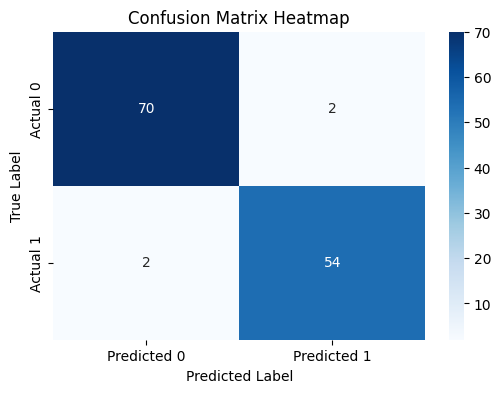

AUC-PR: 0.9633309149590772


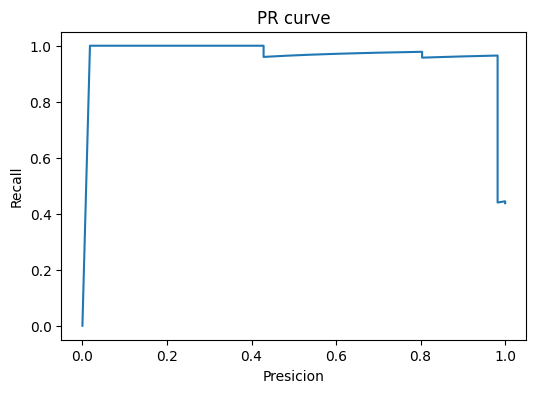

AUC-ROC: 0.9724702380952381


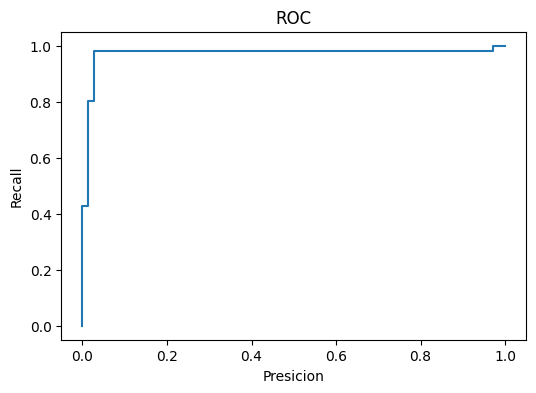

In [6]:
file_path = 'problema1/data/raw/cell_diagnosis_test.csv'
df_test = pd.read_csv(file_path)

df_test = replace_question_marks_with_nan(df_test,'CellType')
df_test = knn_impute_all_optimized(df_test) 
df_test = boxplot_outlier_removal(df_test,exclude=['Diagnosis','CellType','GeneticMutation'])
df_test = one_hot_encode_column(df_test,'CellType')
df_test = convert_to_binary(df_test,'GeneticMutation')
df_test, stats_test = normalize_columns(df_test, stats=stats_train, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])

X_test = df_test.drop(columns=['Diagnosis'])
Y_test = df_test['Diagnosis']

model = LogisticRegressionL2()
model.fit(X_train,Y_train)
Y_pred = model.predict(X_test)
Y_pred_prob = model.predict_proba(X_test)

precision = calculate_precision(Y_test, Y_pred)
print(f'Precision: {precision}')

recall = calculate_recall(Y_test, Y_pred)
print(f'Reacall: {recall}')

accuracy = calculate_accuracy(Y_test, Y_pred)
print(f'Accuracy: {accuracy}')

f_score = calculate_f1_score(Y_test,Y_pred)
print(f'F-score: {f_score}')

conf_matrix = calculate_confusion_matrix(Y_test,Y_pred)

plt.figure(figsize=(6, 4))  # Set figure size
sn.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['Predicted 0', 'Predicted 1'], 
            yticklabels=['Actual 0', 'Actual 1'])
    
# Add labels and title
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix Heatmap')

# Display the plot
plt.show()

precision_vals, recall_vals = calculate_precision_recall_curve(Y_test,Y_pred_prob)
auc_PR = calculate_auc_pr(Y_test,Y_pred_prob) 
print(f'AUC-PR: {auc_PR}')

plt.figure(figsize=(6, 4))  # Set figure size
plt.plot(recall_vals, precision_vals)
# Add labels and title
plt.xlabel('Presicion')
plt.ylabel('Recall')
plt.title('PR curve')

# Display the plot
plt.show()

fpr_vals, tpr_vals = calculate_roc_curve(Y_test,Y_pred_prob)
auc_ROC = calculate_auc_roc(Y_test,Y_pred_prob)
print(f'AUC-ROC: {auc_ROC}')

plt.figure(figsize=(6, 4))  # Set figure size
plt.plot(fpr_vals,tpr_vals)
# Add labels and title
plt.xlabel('Presicion')
plt.ylabel('Recall')
plt.title('ROC')

# Display the plot
plt.show()

## Imbalanced

234 (24.02%) outliers removed
61 (25.00%) outliers removed


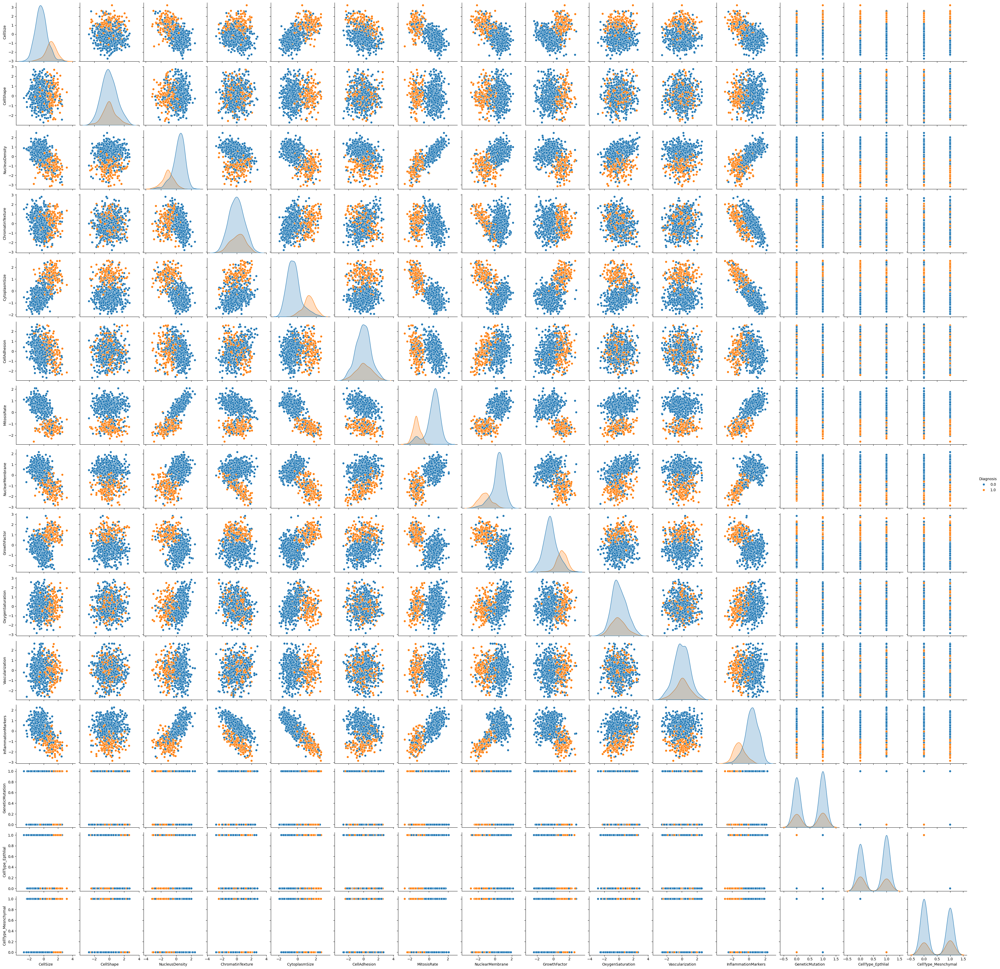

In [7]:
file_path = 'problema1/data/raw/cell_diagnosis_dev_imbalanced.csv'
df_imb = pd.read_csv(file_path)

df_train_imb, df_val_imb = train_val_split(df_imb)

df_train_imb = replace_question_marks_with_nan(df_train_imb,'CellType')
df_train_imb = knn_impute_all_optimized(df_train_imb) 
df_train_imb = boxplot_outlier_removal(df_train_imb,exclude=['Diagnosis','CellType','GeneticMutation'])
df_train_imb = one_hot_encode_column(df_train_imb,'CellType')
df_train_imb = convert_to_binary(df_train_imb,'GeneticMutation')
df_train_imb, stats_train_imb = normalize_columns(df_train_imb, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_train_imb.to_csv('problema1/data/processed/train_imbalanced_cleaned_cell_diagnosis_dev.csv', index=False)

df_val_imb = replace_question_marks_with_nan(df_val_imb,'CellType')
df_val_imb = knn_impute_all_optimized(df_val_imb) 
df_val_imb = boxplot_outlier_removal(df_val_imb,exclude=['Diagnosis','CellType','GeneticMutation'])
df_val_imb = one_hot_encode_column(df_val_imb,'CellType')
df_val_imb = convert_to_binary(df_val_imb,'GeneticMutation')
df_val_imb, stats_val_imb = normalize_columns(df_val_imb, stats=stats_train_imb, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_val_imb.to_csv('problema1/data/processed/val_imbalanced_cleaned_cell_diagnosis_dev.csv', index=False)

sn.pairplot(df_train_imb, hue='Diagnosis')

In [8]:
X_train_imb = df_train_imb.drop(columns=['Diagnosis'])
Y_train_imb = df_train_imb['Diagnosis']

X_val_imb = df_val_imb.drop(columns=['Diagnosis'])
Y_val_imb = df_val_imb['Diagnosis']

imbalanced_model = LogisticRegressionL2()
imbalanced_model.fit(X_train_imb,Y_train_imb)
Y_pred_imb = imbalanced_model.predict(X_val_imb)
Y_pred_prob_imb = imbalanced_model.predict_proba(X_val_imb)

precision_imb = calculate_precision(Y_val_imb, Y_pred_imb)
print(f'Precision: {precision_imb}')

recall_imb = calculate_recall(Y_val_imb, Y_pred_imb)
print(f'Reacall: {recall_imb}')

accuracy_imb = calculate_accuracy(Y_val_imb, Y_pred_imb)
print(f'Accuracy: {accuracy_imb}')

f_score_imb = calculate_f1_score(Y_val_imb,Y_pred_imb)
print(f'F-score: {f_score_imb}')

auc_PR_imb = calculate_auc_pr(Y_val_imb,Y_pred_prob_imb) 
print(f'AUC-PR: {auc_PR_imb}')

auc_ROC_imb = calculate_auc_roc(Y_val_imb,Y_pred_prob_imb)
print(f'AUC-ROC: {auc_ROC_imb}')

precision_vals_imb, recall_vals_imb = calculate_precision_recall_curve(Y_val_imb,Y_pred_prob_imb)

fpr_vals_imb, tpr_vals_imb = calculate_roc_curve(Y_val_imb,Y_pred_prob_imb)

Precision: 0.7659574468085106
Reacall: 0.8780487804878049
Accuracy: 0.912568306010929
F-score: 0.8181818181818182
AUC-PR: 0.7796962334555722
AUC-ROC: 0.9501889385091034


## Undersampling

234 (24.02%) outliers removed
61 (25.00%) outliers removed


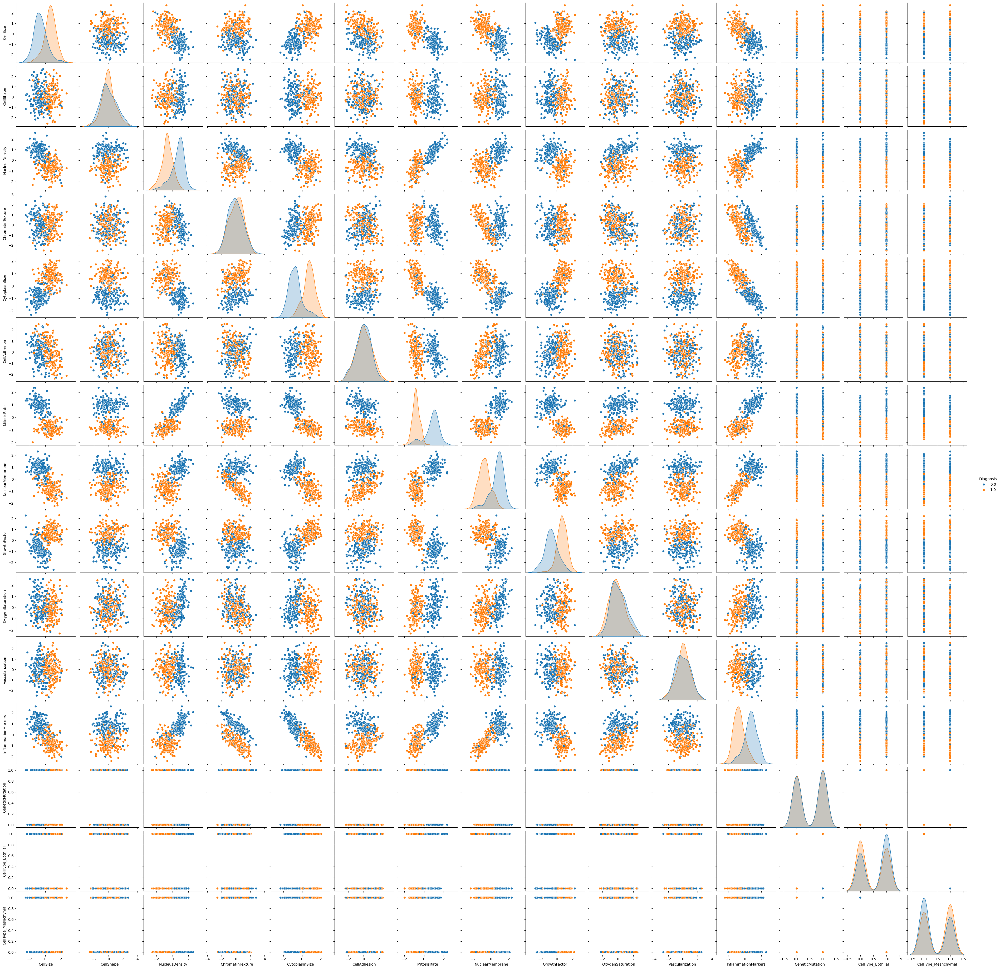

In [9]:
file_path = 'problema1/data/raw/cell_diagnosis_dev_imbalanced.csv'
df_imb_under = pd.read_csv(file_path)

df_train_imb_under, df_val_imb_under = train_val_split(df_imb_under)

df_train_imb_under = replace_question_marks_with_nan(df_train_imb_under,'CellType')
df_train_imb_under = knn_impute_all_optimized(df_train_imb_under) 
df_train_imb_under = boxplot_outlier_removal(df_train_imb_under,exclude=['Diagnosis','CellType','GeneticMutation'])
df_train_imb_under = undersample_data(df_train_imb_under,'Diagnosis')
df_train_imb_under = one_hot_encode_column(df_train_imb_under,'CellType')
df_train_imb_under = convert_to_binary(df_train_imb_under,'GeneticMutation')
df_train_imb_under, stats_train_imb_under = normalize_columns(df_train_imb_under, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_train_imb_under.to_csv('problema1/data/processed/train_imbalanced_cleaned_cell_diagnosis_dev.csv', index=False)

df_val_imb_under = replace_question_marks_with_nan(df_val_imb_under,'CellType')
df_val_imb_under = knn_impute_all_optimized(df_val_imb_under) 
df_val_imb_under = boxplot_outlier_removal(df_val_imb_under,exclude=['Diagnosis','CellType','GeneticMutation'])
df_val_imb_under = one_hot_encode_column(df_val_imb_under,'CellType')
df_val_imb_under = convert_to_binary(df_val_imb_under,'GeneticMutation')
df_val_imb_under, stats_val_imb_under = normalize_columns(df_val_imb_under, stats=stats_train_imb_under, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_val_imb_under.to_csv('problema1/data/processed/val_imbalanced_cleaned_cell_diagnosis_dev.csv', index=False)

sn.pairplot(df_train_imb_under, hue='Diagnosis')

In [10]:
X_train_imb_under = df_train_imb_under.drop(columns=['Diagnosis'])
Y_train_imb_under = df_train_imb_under['Diagnosis']

X_val_imb_under = df_val_imb_under.drop(columns=['Diagnosis'])
Y_val_imb_under = df_val_imb_under['Diagnosis']

imbalanced_model_under = LogisticRegressionL2()
imbalanced_model_under.fit(X_train_imb_under,Y_train_imb_under)
Y_pred_imb_under = imbalanced_model_under.predict(X_val_imb_under)
Y_pred_prob_imb_under = imbalanced_model_under.predict_proba(X_val_imb_under)

precision_imb_under = calculate_precision(Y_val_imb_under, Y_pred_imb_under)
print(f'Precision: {precision_imb_under}')

recall_imb_under = calculate_recall(Y_val_imb_under, Y_pred_imb_under)
print(f'Recall: {recall_imb_under}')

accuracy_imb_under = calculate_accuracy(Y_val_imb_under, Y_pred_imb_under)
print(f'Accuracy: {accuracy_imb_under}')

f_score_imb_under = calculate_f1_score(Y_val_imb_under,Y_pred_imb_under)
print(f'F-score: {f_score_imb_under}')

auc_PR_imb_under = calculate_auc_pr(Y_val_imb_under,Y_pred_prob_imb_under) 
print(f'AUC-PR: {auc_PR_imb_under}')

auc_ROC_imb_under = calculate_auc_roc(Y_val_imb_under,Y_pred_prob_imb_under)
print(f'AUC-ROC: {auc_ROC_imb_under}')

precision_vals_imb_under, recall_vals_imb_under = calculate_precision_recall_curve(Y_val_imb_under,Y_pred_prob_imb_under)

fpr_vals_imb_under, tpr_vals_imb_under = calculate_roc_curve(Y_val_imb_under,Y_pred_prob_imb_under)

Precision: 0.7692307692307693
Recall: 0.975609756097561
Accuracy: 0.9289617486338798
F-score: 0.860215053763441
AUC-PR: 0.7532101671876154
AUC-ROC: 0.9527653727241497


## Oversampling duplicate

234 (24.02%) outliers removed
61 (25.00%) outliers removed


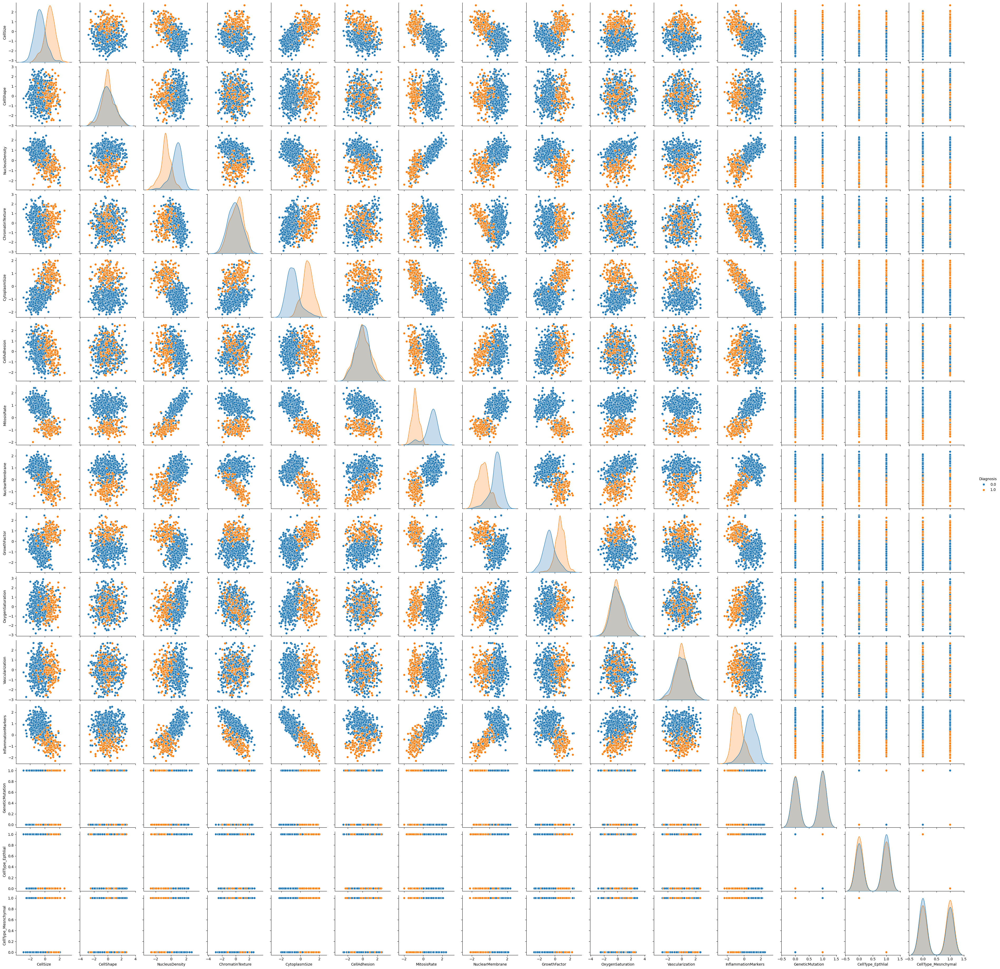

In [11]:
file_path = 'problema1/data/raw/cell_diagnosis_dev_imbalanced.csv'
df_imb_over_dup = pd.read_csv(file_path)

df_train_imb_over_dup, df_val_imb_over_dup = train_val_split(df_imb_over_dup)

df_train_imb_over_dup = replace_question_marks_with_nan(df_train_imb_over_dup,'CellType')
df_train_imb_over_dup = knn_impute_all_optimized(df_train_imb_over_dup) 
df_train_imb_over_dup = boxplot_outlier_removal(df_train_imb_over_dup,exclude=['Diagnosis','CellType','GeneticMutation'])
df_train_imb_over_dup = oversample_data_dup(df_train_imb_over_dup,'Diagnosis')
df_train_imb_over_dup = one_hot_encode_column(df_train_imb_over_dup,'CellType')
df_train_imb_over_dup = convert_to_binary(df_train_imb_over_dup,'GeneticMutation')
df_train_imb_over_dup, stats_train_imb_over_dup = normalize_columns(df_train_imb_over_dup, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_train_imb_over_dup.to_csv('problema1/data/processed/train_imbalanced_cleaned_cell_diagnosis_dev.csv', index=False)

df_val_imb_over_dup = replace_question_marks_with_nan(df_val_imb_over_dup,'CellType')
df_val_imb_over_dup = knn_impute_all_optimized(df_val_imb_over_dup) 
df_val_imb_over_dup = boxplot_outlier_removal(df_val_imb_over_dup,exclude=['Diagnosis','CellType','GeneticMutation'])
df_val_imb_over_dup = one_hot_encode_column(df_val_imb_over_dup,'CellType')
df_val_imb_over_dup = convert_to_binary(df_val_imb_over_dup,'GeneticMutation')
df_val_imb_over_dup, stats_val_imb_over_dup = normalize_columns(df_val_imb_over_dup, stats=stats_train_imb_over_dup, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_val_imb_over_dup.to_csv('problema1/data/processed/val_imbalanced_cleaned_cell_diagnosis_dev.csv', index=False)

sn.pairplot(df_train_imb_over_dup, hue='Diagnosis')

In [12]:
X_train_imb_over_dup = df_train_imb_over_dup.drop(columns=['Diagnosis'])
Y_train_imb_over_dup = df_train_imb_over_dup['Diagnosis']

X_val_imb_over_dup = df_val_imb_over_dup.drop(columns=['Diagnosis'])
Y_val_imb_over_dup = df_val_imb_over_dup['Diagnosis']

imb_model_over_dup = LogisticRegressionL2()
imb_model_over_dup.fit(X_train_imb_over_dup,Y_train_imb_over_dup)
Y_pred_imb_over_dup = imb_model_over_dup.predict(X_val_imb_over_dup)
Y_pred_prob_imb_over_dup = imb_model_over_dup.predict_proba(X_val_imb_over_dup)

precision_imb_over_dup = calculate_precision(Y_val_imb_over_dup, Y_pred_imb_over_dup)
print(f'Precision: {precision_imb_over_dup}')

recall_imb_over_dup = calculate_recall(Y_val_imb_over_dup, Y_pred_imb_over_dup)
print(f'Recall: {recall_imb_over_dup}')

accuracy_imb_over_dup = calculate_accuracy(Y_val_imb_over_dup, Y_pred_imb_over_dup)
print(f'Accuracy: {accuracy_imb_over_dup}')

f_score_imb_over_dup = calculate_f1_score(Y_val_imb_over_dup, Y_pred_imb_over_dup)
print(f'F-score: {f_score_imb_over_dup}')

auc_PR_imb_over_dup = calculate_auc_pr(Y_val_imb_over_dup, Y_pred_prob_imb_over_dup) 
print(f'AUC-PR: {auc_PR_imb_over_dup}')

auc_ROC_imb_over_dup = calculate_auc_roc(Y_val_imb_over_dup, Y_pred_prob_imb_over_dup)
print(f'AUC-ROC: {auc_ROC_imb_over_dup}')

precision_vals_imb_over_dup, recall_vals_imb_over_dup = calculate_precision_recall_curve(Y_val_imb_over_dup,Y_pred_prob_imb_over_dup)

fpr_vals_imb_over_dup, tpr_vals_imb_over_dup = calculate_roc_curve(Y_val_imb_over_dup,Y_pred_prob_imb_over_dup)

Precision: 0.7692307692307693
Recall: 0.975609756097561
Accuracy: 0.9289617486338798
F-score: 0.860215053763441
AUC-PR: 0.7638887158141875
AUC-ROC: 0.9543112332531776


## Oversampling SMOTE

234 (24.02%) outliers removed
61 (25.00%) outliers removed


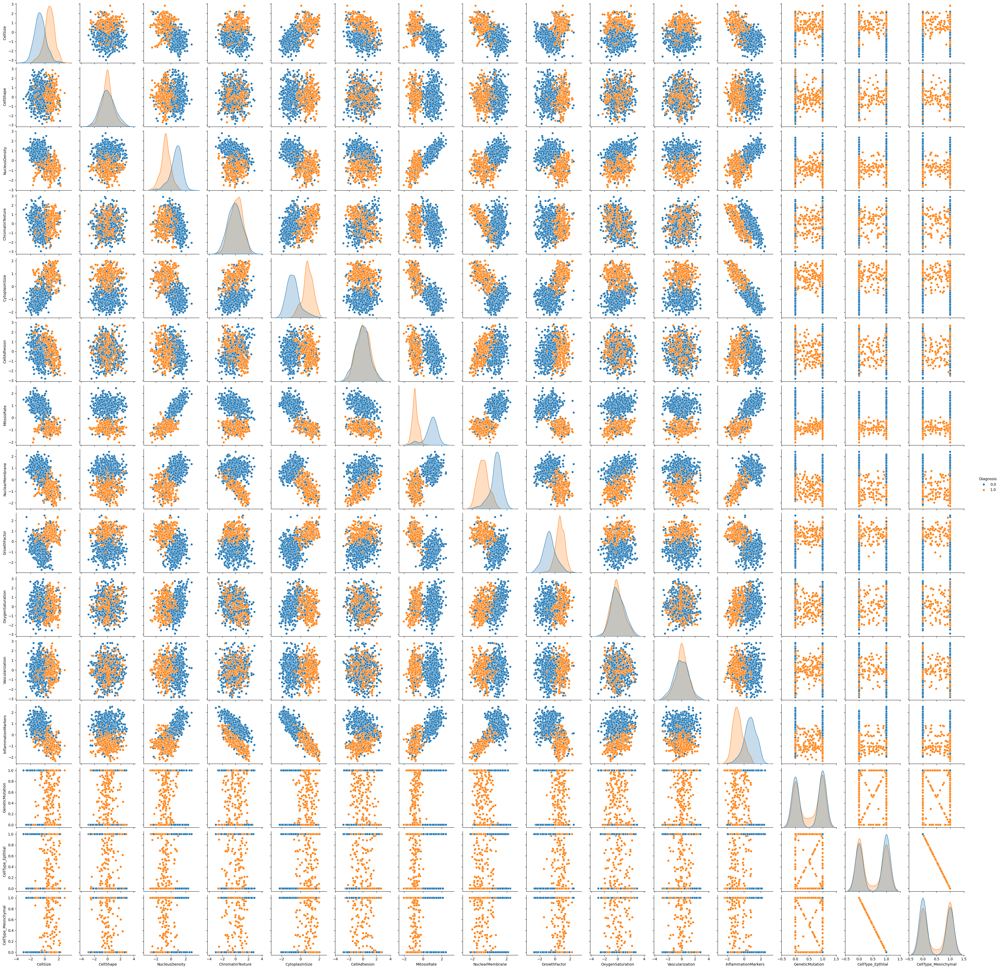

In [13]:
file_path = 'problema1/data/raw/cell_diagnosis_dev_imbalanced.csv'
df_imb_over_SMOTE = pd.read_csv(file_path)

df_train_imb_over_SMOTE, df_val_imb_over_SMOTE = train_val_split(df_imb_over_SMOTE)

df_train_imb_over_SMOTE = replace_question_marks_with_nan(df_train_imb_over_SMOTE,'CellType')
df_train_imb_over_SMOTE = knn_impute_all_optimized(df_train_imb_over_SMOTE) 
df_train_imb_over_SMOTE = boxplot_outlier_removal(df_train_imb_over_SMOTE, exclude=['Diagnosis','CellType','GeneticMutation'])
df_train_imb_over_SMOTE = one_hot_encode_column(df_train_imb_over_SMOTE,'CellType')
df_train_imb_over_SMOTE = convert_to_binary(df_train_imb_over_SMOTE,'GeneticMutation')
df_train_imb_over_SMOTE = oversample_smote(df_train_imb_over_SMOTE,'Diagnosis')
df_train_imb_over_SMOTE, stats_train_imb_over_SMOTE = normalize_columns(df_train_imb_over_SMOTE, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_train_imb_over_SMOTE.to_csv('problema1/data/processed/train_imbalanced_cleaned_cell_diagnosis_dev.csv', index=False)

df_val_imb_over_SMOTE = replace_question_marks_with_nan(df_val_imb_over_SMOTE,'CellType')
df_val_imb_over_SMOTE = knn_impute_all_optimized(df_val_imb_over_SMOTE) 
df_val_imb_over_SMOTE = boxplot_outlier_removal(df_val_imb_over_SMOTE,exclude=['Diagnosis','CellType','GeneticMutation'])
df_val_imb_over_SMOTE = one_hot_encode_column(df_val_imb_over_SMOTE,'CellType')
df_val_imb_over_SMOTE = convert_to_binary(df_val_imb_over_SMOTE,'GeneticMutation')
df_val_imb_over_SMOTE, stats_val_imb_over_SMOTE = normalize_columns(df_val_imb_over_SMOTE, stats=stats_train_imb_over_SMOTE, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_val_imb_over_SMOTE.to_csv('problema1/data/processed/val_imbalanced_cleaned_cell_diagnosis_dev.csv', index=False)

sn.pairplot(df_train_imb_over_SMOTE, hue='Diagnosis')

In [14]:
X_train_imb_over_SMOTE = df_train_imb_over_SMOTE.drop(columns=['Diagnosis'])
Y_train_imb_over_SMOTE = df_train_imb_over_SMOTE['Diagnosis']

X_val_imb_over_SMOTE = df_val_imb_over_SMOTE.drop(columns=['Diagnosis'])
Y_val_imb_over_SMOTE = df_val_imb_over_SMOTE['Diagnosis']

imb_model_over_SMOTE = LogisticRegressionL2()
imb_model_over_SMOTE.fit(X_train_imb_over_SMOTE, Y_train_imb_over_SMOTE)
Y_pred_imb_over_SMOTE = imb_model_over_SMOTE.predict(X_val_imb_over_SMOTE)
Y_pred_prob_imb_over_SMOTE = imb_model_over_SMOTE.predict_proba(X_val_imb_over_SMOTE)

precision_imb_over_SMOTE = calculate_precision(Y_val_imb_over_SMOTE, Y_pred_imb_over_SMOTE)
print(f'Precision: {precision_imb_over_SMOTE}')

recall_imb_over_SMOTE = calculate_recall(Y_val_imb_over_SMOTE, Y_pred_imb_over_SMOTE)
print(f'Recall: {recall_imb_over_SMOTE}')

accuracy_imb_over_SMOTE = calculate_accuracy(Y_val_imb_over_SMOTE, Y_pred_imb_over_SMOTE)
print(f'Accuracy: {accuracy_imb_over_SMOTE}')

f_score_imb_over_SMOTE = calculate_f1_score(Y_val_imb_over_SMOTE, Y_pred_imb_over_SMOTE)
print(f'F-score: {f_score_imb_over_SMOTE}')

auc_PR_imb_over_SMOTE = calculate_auc_pr(Y_val_imb_over_SMOTE, Y_pred_prob_imb_over_SMOTE) 
print(f'AUC-PR: {auc_PR_imb_over_SMOTE}')

auc_ROC_imb_over_SMOTE = calculate_auc_roc(Y_val_imb_over_SMOTE, Y_pred_prob_imb_over_SMOTE)
print(f'AUC-ROC: {auc_ROC_imb_over_SMOTE}')

precision_vals_imb_over_SMOTE, recall_vals_imb_over_SMOTE = calculate_precision_recall_curve(Y_val_imb_over_SMOTE,Y_pred_prob_imb_over_SMOTE)

fpr_vals_imb_over_SMOTE, tpr_vals_imb_over_SMOTE = calculate_roc_curve(Y_val_imb_over_SMOTE,Y_pred_prob_imb_over_SMOTE)

Precision: 0.7692307692307693
Recall: 0.975609756097561
Accuracy: 0.9289617486338798
F-score: 0.860215053763441
AUC-PR: 0.7565919857479732
AUC-ROC: 0.9543112332531776


## Cost re-weighting

In [15]:
file_path = 'problema1/data/raw/cell_diagnosis_dev_imbalanced.csv'
df_imb_cost = pd.read_csv(file_path)

df_train_imb_cost, df_val_imb_cost = train_val_split(df_imb_cost)

df_train_imb_cost = replace_question_marks_with_nan(df_train_imb_cost,'CellType')
df_train_imb_cost = knn_impute_all_optimized(df_train_imb_cost) 
df_train_imb_cost = boxplot_outlier_removal(df_train_imb_cost, exclude=['Diagnosis','CellType','GeneticMutation'])
df_train_imb_cost = one_hot_encode_column(df_train_imb_cost,'CellType')
df_train_imb_cost = convert_to_binary(df_train_imb_cost,'GeneticMutation')
df_train_imb_cost, stats_train_imb_cost = normalize_columns(df_train_imb_cost, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_train_imb_cost.to_csv('problema1/data/processed/train_imbalanced_cleaned_cell_diagnosis_dev.csv', index=False)

df_val_imb_cost = replace_question_marks_with_nan(df_val_imb_cost,'CellType')
df_val_imb_cost = knn_impute_all_optimized(df_val_imb_cost) 
df_val_imb_cost = boxplot_outlier_removal(df_val_imb_cost,exclude=['Diagnosis','CellType','GeneticMutation'])
df_val_imb_cost = one_hot_encode_column(df_val_imb_cost,'CellType')
df_val_imb_cost = convert_to_binary(df_val_imb_cost,'GeneticMutation')
df_val_imb_cost, stats_val_imb_cost = normalize_columns(df_val_imb_cost, stats=stats_train_imb_cost, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_val_imb_cost.to_csv('problema1/data/processed/val_imbalanced_cleaned_cell_diagnosis_dev.csv', index=False)

234 (24.02%) outliers removed
61 (25.00%) outliers removed


In [16]:
X_train_imb_cost = df_train_imb_cost.drop(columns=['Diagnosis'])
Y_train_imb_cost = df_train_imb_cost['Diagnosis']

X_val_imb_cost = df_val_imb_cost.drop(columns=['Diagnosis'])
Y_val_imb_cost = df_val_imb_cost['Diagnosis']

imb_model_cost = LogisticRegressionL2_cost(cost_fn=2.0)
imb_model_cost.fit(X_train_imb_cost, Y_train_imb_cost)
Y_pred_imb_cost = imb_model_cost.predict(X_val_imb_cost)
Y_pred_prob_imb_cost = imb_model_cost.predict_proba(X_val_imb_cost)

precision_imb_cost = calculate_precision(Y_val_imb_cost, Y_pred_imb_cost)
print(f'Precision: {precision_imb_cost}')

recall_imb_cost = calculate_recall(Y_val_imb_cost, Y_pred_imb_cost)
print(f'Recall: {recall_imb_cost}')

accuracy_imb_cost = calculate_accuracy(Y_val_imb_cost, Y_pred_imb_cost)
print(f'Accuracy: {accuracy_imb_cost}')

f_score_imb_cost = calculate_f1_score(Y_val_imb_cost, Y_pred_imb_cost)
print(f'F-score: {f_score_imb_cost}')

auc_PR_imb_cost = calculate_auc_pr(Y_val_imb_cost, Y_pred_prob_imb_cost) 
print(f'AUC-PR: {auc_PR_imb_cost}')

auc_ROC_imb_cost = calculate_auc_roc(Y_val_imb_cost, Y_pred_prob_imb_cost)
print(f'AUC-ROC: {auc_ROC_imb_cost}')

precision_vals_imb_cost, recall_vals_imb_cost = calculate_precision_recall_curve(Y_val_imb_cost,Y_pred_prob_imb_cost)

fpr_vals_imb_cost, tpr_vals_imb_cost = calculate_roc_curve(Y_val_imb_cost,Y_pred_prob_imb_cost)

Precision: 0.7692307692307693
Recall: 0.975609756097561
Accuracy: 0.9289617486338798
F-score: 0.860215053763441
AUC-PR: 0.7830888525868047
AUC-ROC: 0.9527653727241499


In [ ]:
all_precisions = [precision_imb, precision_imb_under, precision_imb_over_dup, precision_imb_over_SMOTE, precision_imb_cost]
all_accuracys = [accuracy_imb, accuracy_imb_under, accuracy_imb_over_dup, accuracy_imb_over_SMOTE, accuracy_imb_cost]
all_recalls = [recall_imb, recall_imb_under, recall_imb_over_dup, recall_imb_over_SMOTE, recall_imb_cost]
all_f_scores = [f_score_imb, f_score_imb_under, f_score_imb_over_dup, f_score_imb_over_SMOTE, f_score_imb_cost]
all_auc_PRs = [auc_PR_imb, auc_PR_imb_under, auc_PR_imb_over_dup, auc_PR_imb_over_SMOTE, auc_PR_imb_cost]
all_auc_ROCs = [auc_ROC_imb, auc_ROC_imb_under, auc_ROC_imb_over_dup, auc_ROC_imb_over_SMOTE, auc_ROC_imb_cost]

all_metrics = [all_accuracys, all_precisions, all_recalls, all_f_scores, all_auc_ROCs, all_auc_PRs]
print(all_precisions)
print_results_table_from_lists(all_metrics)

| Modelo                 | Accuracy | Precision | Recall | F-Score | AUC-ROC | AUC-PR |
|------------------------|----------|-----------|--------|---------|---------|--------|
| Sin rebalanceo         | 0.913    | 0.766     | 0.878  | 0.818   | 0.950   | 0.780  |
| Undersampling          | 0.929    | 0.769     | 0.976  | 0.860   | 0.953   | 0.753  |
| Oversampling duplicate | 0.929    | 0.769     | 0.976  | 0.860   | 0.954   | 0.764  |
| Oversampling SMOTE     | 0.929    | 0.769     | 0.976  | 0.860   | 0.954   | 0.757  |
| Cost re-weighting      | 0.929    | 0.769     | 0.976  | 0.860   | 0.953   | 0.783  |
